<img src="https://github.com/RadimKozl/OpenCV_Project4/blob/832738cf629a0d6518297f860fd1952e3eaa3143/notebooks/img/OpenCV_logo.png" alt="OpenCV logo" style="width: 200px;"/>

###### <font size="10">Custom YOLO object detector, using trained ONNX model using onnxruntime library</font>

# Introduction

In this notebook we will demonstrate the use of the *.onnx model using the onnxruntime library.


# Housekeeping

In [1]:
# !pip install opencv-python
# !pip install opencv-contrib-python
# !pip install opencv-python-headless
# !pip install opencv-contrib-python-headless
# !pip install ultralytics
# !pip install pillow
# !pip install onnx
# !pip install onnxruntime 

In [2]:
import os
os.chdir('C:\\Users\\kozl\\ITProjects\\DataScienciPython\\data_science_python_training\\lessons\\OpenCV\\lesson26\\coursework\\notebooks')

In [3]:
import cv2, sys, os, csv

import numpy as np
import matplotlib
import matplotlib.pyplot as plt

import pickle

from dataPath import MODEL_PATH, IMAGES_PATH, RESULTS_PATH, PICKLE_PATH

from ultralytics import YOLO
from PIL import Image, ImageDraw, ImageFont
import onnxruntime as ort
from IPython.display import display

import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual, IntSlider, Output
from ipywidgets.widgets.interaction import interactive
from IPython.display import display

%matplotlib inline

In [4]:
matplotlib.rcParams['figure.figsize'] = (8.0,8.0)
matplotlib.rcParams['image.cmap'] = 'gray'
matplotlib.rcParams['image.interpolation'] = 'bilinear'

### ***Defining the necessary paths***

In [5]:
# path to the model YOLO
path_model_dir = os.path.join(MODEL_PATH, 'onnx')
# path directory for load test images
path_images_dir = os.path.join(IMAGES_PATH, 'test_images')
# path directory for save results onnx model
path_results_dir = os.path.join(IMAGES_PATH, 'results', 'onnxruntime')

### ***Loading ONNX model***

In [6]:
list_onnx_paths = {}
list_onnx_names = []

In [7]:
def load_onnx(path_dir):
    list_files = os.listdir(path_dir)
    list_onnx_files = [file for file in list_files if os.path.isfile(os.path.join(path_dir, file)) and file.endswith('.onnx')]
    return list_onnx_files

In [8]:
list_onnx_files = load_onnx(path_model_dir)
list_onnx_files

['YOLOv10m_FMD_01.onnx',
 'YOLOv10m_FMD_02.onnx',
 'YOLOv5m_FMD.onnx',
 'YOLOv6m_FMD_01.onnx',
 'YOLOv6m_FMD_02.onnx',
 'YOLOv7_FMD_01.onnx',
 'YOLOv7_FMD_02.onnx',
 'YOLOv7_FMD_03.onnx',
 'YOLOv8m_FMD.onnx',
 'YOLOv9m_FMD.onnx']

In [9]:
for file in list_onnx_files:
    name = str(file.split('.')[0])
    path = os.path.join(path_model_dir, file)
    list_onnx_paths[name] = path
    list_onnx_names.append(name)

In [10]:
list_onnx_paths

{'YOLOv10m_FMD_01': '..\\data\\models\\onnx\\YOLOv10m_FMD_01.onnx',
 'YOLOv10m_FMD_02': '..\\data\\models\\onnx\\YOLOv10m_FMD_02.onnx',
 'YOLOv5m_FMD': '..\\data\\models\\onnx\\YOLOv5m_FMD.onnx',
 'YOLOv6m_FMD_01': '..\\data\\models\\onnx\\YOLOv6m_FMD_01.onnx',
 'YOLOv6m_FMD_02': '..\\data\\models\\onnx\\YOLOv6m_FMD_02.onnx',
 'YOLOv7_FMD_01': '..\\data\\models\\onnx\\YOLOv7_FMD_01.onnx',
 'YOLOv7_FMD_02': '..\\data\\models\\onnx\\YOLOv7_FMD_02.onnx',
 'YOLOv7_FMD_03': '..\\data\\models\\onnx\\YOLOv7_FMD_03.onnx',
 'YOLOv8m_FMD': '..\\data\\models\\onnx\\YOLOv8m_FMD.onnx',
 'YOLOv9m_FMD': '..\\data\\models\\onnx\\YOLOv9m_FMD.onnx'}

In [11]:
list_onnx_names

['YOLOv10m_FMD_01',
 'YOLOv10m_FMD_02',
 'YOLOv5m_FMD',
 'YOLOv6m_FMD_01',
 'YOLOv6m_FMD_02',
 'YOLOv7_FMD_01',
 'YOLOv7_FMD_02',
 'YOLOv7_FMD_03',
 'YOLOv8m_FMD',
 'YOLOv9m_FMD']

In [12]:
def sel_onnx(name):
    data = (name, list_onnx_paths[name])
    file_path = os.path.join(PICKLE_PATH, 'sel_data.pkl')
    with open(file_path, 'wb') as f:  
        pickle.dump(data, f)
    return data

In [13]:
path_model = interact(sel_onnx, name=list_onnx_names);
path_model

interactive(children=(Dropdown(description='name', options=('YOLOv10m_FMD_01', 'YOLOv10m_FMD_02', 'YOLOv5m_FMD…

<function __main__.sel_onnx(name)>

In [141]:
with open(os.path.join(PICKLE_PATH, 'sel_data.pkl'), 'rb') as f:
    sel_data = pickle.load(f)

In [142]:
sess_options = ort.SessionOptions()
sess_options.log_severity_level = 0

In [143]:
# Load the exported ONNX model
model = ort.InferenceSession(sel_data[1], sess_options, providers=['CPUExecutionProvider'])

In [144]:
# read inputs of model
inputs = model.get_inputs();
len(inputs)

1

### ***We examine the input of the ONNX model***

In [145]:
input = inputs[0]
help(input)

Help on NodeArg in module onnxruntime.capi.onnxruntime_pybind11_state object:

class NodeArg(pybind11_builtins.pybind11_object)
 |  Node argument definition, for both input and output,
 |  including arg name, arg type (contains both type and shape).
 |  
 |  Method resolution order:
 |      NodeArg
 |      pybind11_builtins.pybind11_object
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  __init__(self, /, *args, **kwargs)
 |      Initialize self.  See help(type(self)) for accurate signature.
 |  
 |  __str__(...)
 |      __str__(self: onnxruntime.capi.onnxruntime_pybind11_state.NodeArg) -> str
 |      
 |      converts the node into a readable string
 |  
 |  ----------------------------------------------------------------------
 |  Readonly properties defined here:
 |  
 |  name
 |      node name
 |  
 |  shape
 |      node shape (assuming the node holds a tensor)
 |  
 |  type
 |      node type
 |  
 |  ------------------------------------------------------------------

In [146]:
print("Name:",input.name)
print("Type:",input.type)
print("Shape:",input.shape)

Name: input
Type: tensor(float)
Shape: [1, 3, 640, 640]


### ***We will pre-prepare the input using the Pillow library***

In [147]:
def load_images(path_dir):
    list_files = os.listdir(path_dir)
    list_jpg_files = [file for file in list_files if os.path.isfile(os.path.join(path_dir, file)) and file.endswith('.jpg')]
    return list_jpg_files

In [148]:
def prepare_image(path_image):
    # dictionary of results
    results_dictionary = {}
    # load image by pillow
    img = Image.open(path_image)
    # set dimension of image
    img_width, img_height = img.size;
    # resize image for input dimension
    img = img.resize((640,640))
    # Delete Alpha channel, set image as RGB
    img = img.convert("RGB");
    # converting image to numpy array
    input = np.array(img)
    #print('base shape array: ', input.shape)
    # dimensions go in wrong order, correct it
    input = input.transpose(2,0,1)
    #print('shape array with true order: ', input.shape)
    # add one more dimension to the beginning
    input = input.reshape(1,3,640,640)
    #print('new dimension of array: ', input.shape)
    #print('Test value: ',input[0,0,0,0])
    # numbers for machine learning must be scaled
    input = input/255.0
    #print('Scaled test value: ', input[0,0,0,0])
    # Konverze na typ float32
    input = input.astype(np.float32)

    results_dictionary['input'] = input
    results_dictionary['origin_image_dimension'] = (img_width, img_height)

    return results_dictionary


In [149]:
list_images = load_images(path_images_dir)
list_images

['test-image1.jpg', 'test-image2.jpg', 'test-image3.jpg', 'test-image4.jpg']

In [150]:
list_preprocess_inputs = {}

for img in list_images:
    path_img = os.path.join(path_images_dir, img)
    input = prepare_image(path_img)
    list_preprocess_inputs[img] = input

print('Show inputs: ', list_preprocess_inputs)

Show inputs:  {'test-image1.jpg': {'input': array([[[[    0.46667,     0.47451,     0.48235, ...,     0.29412,     0.29412,     0.29412],
         [    0.46667,     0.47059,     0.47451, ...,     0.29412,     0.29412,     0.29412],
         [    0.46667,     0.47451,     0.48235, ...,     0.29412,     0.29412,     0.29412],
         ...,
         [   0.082353,    0.070588,    0.070588, ...,     0.38039,     0.38039,     0.38039],
         [   0.054902,    0.070588,    0.070588, ...,     0.38431,     0.38039,     0.38431],
         [   0.066667,    0.058824,    0.098039, ...,     0.38039,     0.38039,     0.38431]],

        [[    0.76863,     0.77255,     0.77255, ...,     0.67843,     0.67843,     0.67843],
         [    0.77255,     0.76863,     0.76471, ...,     0.67843,     0.67843,     0.67843],
         [    0.76863,     0.77255,     0.77255, ...,     0.67843,     0.67843,     0.67843],
         ...,
         [    0.16078,     0.14118,     0.13333, ...,     0.70588,     0.70588, 

### ***Now we examine the output of the ONNX model***

In [151]:
# read outputs of model
outputs = model.get_outputs()
print(len(outputs))

1


In [152]:
output = outputs[0]
help(output)

Help on NodeArg in module onnxruntime.capi.onnxruntime_pybind11_state object:

class NodeArg(pybind11_builtins.pybind11_object)
 |  Node argument definition, for both input and output,
 |  including arg name, arg type (contains both type and shape).
 |  
 |  Method resolution order:
 |      NodeArg
 |      pybind11_builtins.pybind11_object
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  __init__(self, /, *args, **kwargs)
 |      Initialize self.  See help(type(self)) for accurate signature.
 |  
 |  __str__(...)
 |      __str__(self: onnxruntime.capi.onnxruntime_pybind11_state.NodeArg) -> str
 |      
 |      converts the node into a readable string
 |  
 |  ----------------------------------------------------------------------
 |  Readonly properties defined here:
 |  
 |  name
 |      node name
 |  
 |  shape
 |      node shape (assuming the node holds a tensor)
 |  
 |  type
 |      node type
 |  
 |  ------------------------------------------------------------------

In [153]:
print("Name:",output.name)
print("Type:",output.type)
print("Shape:",output.shape)

Name: output
Type: tensor(float)
Shape: [1, 8500, 7]


### ***Let's run the ONNX model prediction for our data***

```python
model.run(output_names,inputs)
```

- `output_names`: pole názvů výstupů, které chcete přijímat. V modelu YOLOv10 to bude pole s jednou položkou.
- `inputs`: slovník vstupů, který předáte do sítě ve formátu *{name:tensor}*, kde `name` je jméno vstupu a `tenzor` je pole obrazových dat, které jsme připravili dříve.

In [154]:
# create predictions
output_predictions = {}

for image_name in list_preprocess_inputs.keys():
    #print(image_name)
    input = list_preprocess_inputs[image_name]['input']
    origin_image_dimension = list_preprocess_inputs[image_name]['origin_image_dimension']
    if output.name == "output0":
        outputs = model.run(["output0"], {"images":input})
    elif output.name == "outputs":
        outputs = model.run(["outputs"], {"images":input})
    elif output.name == "output":
        input_name = model.get_inputs()[0].name
        input_data = np.random.randn(1, 3, 640, 640).astype(np.float32)
        outputs = model.run(None, {input_name: input_data})
    #print(len(outputs))
    output_predictions[image_name] = {'outputs': outputs, 'origin_image_dimension': origin_image_dimension}
    print(output_predictions)

{'test-image1.jpg': {'outputs': [array([[[     6.4404,      6.9856,      13.209, ...,           1,     0.03098,    0.047574],
        [     11.957,      4.4932,      21.719, ...,           1,     0.02498,    0.038778],
        [     25.593,      3.9257,      40.828, ...,           1,     0.02663,    0.037655],
        ...,
        [     316.27,      558.94,      978.97, ...,           1,     0.01001,    0.010009],
        [      408.5,       561.5,      891.27, ...,           1,     0.01001,    0.010009],
        [     416.99,      565.23,      983.51, ...,           1,    0.010009,    0.010009]]], dtype=float32)], 'origin_image_dimension': (1120, 1638)}}
{'test-image1.jpg': {'outputs': [array([[[     6.4404,      6.9856,      13.209, ...,           1,     0.03098,    0.047574],
        [     11.957,      4.4932,      21.719, ...,           1,     0.02498,    0.038778],
        [     25.593,      3.9257,      40.828, ...,           1,     0.02663,    0.037655],
        ...,
        [  

### ***We will process the output***

In [155]:
def parse_row(row, img_width, img_height, class_names):
    # slice out tx_center, y_center, width, height from the row
    xc,yc,w,h = row[:4]

    # calculate coordinates of bounding box corners
    x1 = (xc-w/2)/640*img_width
    y1 = (yc-h/2)/640*img_height
    x2 = (xc+w/2)/640*img_width
    y2 = (yc+h/2)/640*img_height

    # find the object with a maximum probability
    prob = row[4:].max()
    # id of class
    class_id = row[4:].argmax()

    # Check class annotation, note: YOLOv7 have different annotation 1,2 not 0,1!!!
    if (len(class_names)-1) < class_id:
        # get a class label by ID
        label = class_names[(class_id-1)]
    else:
        # get a class label by ID
        label = class_names[class_id]
    
    return [x1, y1, x2, y2, label, prob]

In [156]:
def process_ouputs(outputs, image_dimension, class_names, threshold=0.5):
    # origin image dimension
    img_width, img_height = image_dimension
    
    # select predicted output
    output = outputs[0]
    #print('base output shape: ', output.shape)
    print(type(output))

    # first dimension has only single item, we can just get it
    output = output[0]
    print()
    #print('Updated output shape: ', output.shape)
    
    # Check Output shape
    output_shape = output.shape
        
    # We turned it out to a matrix with 84 rows and, 8400 columns.
    if output_shape[0] < output_shape[1]:
        output = output.transpose()
        #print('Turned output shape: ', output.shape)
    else:
        output = output
    
    #print('-'*10)
    #for row in output:
    #    print(row)
    #print('-'*10)
        
    # parses and filter outs all rows from output
    boxes = [row for row in [parse_row(row, img_width, img_height, class_names) for row in output] if row[5] > threshold]
    #print(len(boxes))

    return boxes


In [157]:
# Define YOLO classes, form YAML file of train process
yolo_classes = ['mask', 'no-mask']

In [158]:
boxes_results = {}

In [159]:
def check_threshold(threshold):
    file_path = os.path.join(PICKLE_PATH, 'threshold.pkl')
    with open(file_path, 'wb') as f:  
        pickle.dump(round(threshold, 2), f)
    return threshold

In [160]:
interact(check_threshold, threshold=widgets.FloatSlider(min=0.1, max=1.0, step=0.01, value=0.50));

interactive(children=(FloatSlider(value=0.5, description='threshold', max=1.0, min=0.1, step=0.01), Output()),…

In [179]:
with open(os.path.join(PICKLE_PATH, 'threshold.pkl'), 'rb') as f:
    threshold = pickle.load(f)

print(threshold)

0.99


In [180]:
for image_name in output_predictions.keys():
    # select outputs
    outputs = output_predictions[image_name]['outputs']
    # select origin image dimensions
    image_dim = output_predictions[image_name]['origin_image_dimension']

    # calculate boxes of detection and other information
    print(image_name, 'process done')
    boxes_outputs = process_ouputs(outputs, image_dim, yolo_classes, threshold=threshold)

    boxes_results[image_name] = boxes_outputs

test-image1.jpg process done
<class 'numpy.ndarray'>

test-image2.jpg process done
<class 'numpy.ndarray'>

test-image3.jpg process done
<class 'numpy.ndarray'>

test-image4.jpg process done
<class 'numpy.ndarray'>



In [181]:
#boxes_results

### ***Rendering Predicted Detection Frames***

In [182]:
# Define a color map for different classes
COLOR_MAP = {
    'mask': "#00FF00",  # Green for class 0 (mask)
    'no-mask': "#FF0000",  # Red for class 1 (no-mask)
    # Add more classes and colors as needed
}

# Set the font size
FONT_SIZE = 20  # Adjust the size as needed
FONT_PATH = "/usr/share/fonts/truetype/dejavu/DejaVuSans-Bold.ttf"  # You may need to change this path based on your environment

In [183]:
# Funkce pro vykreslení detekcí na obrázku
def draw_boxes(image_path, boxes):
    img = Image.open(image_path)
    draw = ImageDraw.Draw(img)

    width, height = img.size
    ratio = height/width

    # Load the font
    font = ImageFont.truetype(FONT_PATH, int(FONT_SIZE*ratio))
    
    for box in boxes:
        x1, y1, x2, y2, class_id, prob = box
        # Get color based on class_id
        color = COLOR_MAP.get(class_id, "#FFFFFF")  # Default to white if class_id not in map
        draw.rectangle((x1, y1, x2, y2), outline=color, width=2)
        draw.text((x1, y1 - (int(ratio*FONT_SIZE)+1)), f'{class_id} {prob:.2f}', font=font, fill=color)

    # Zobrazení obrázku v Jupyter Lab
    display(img)
    

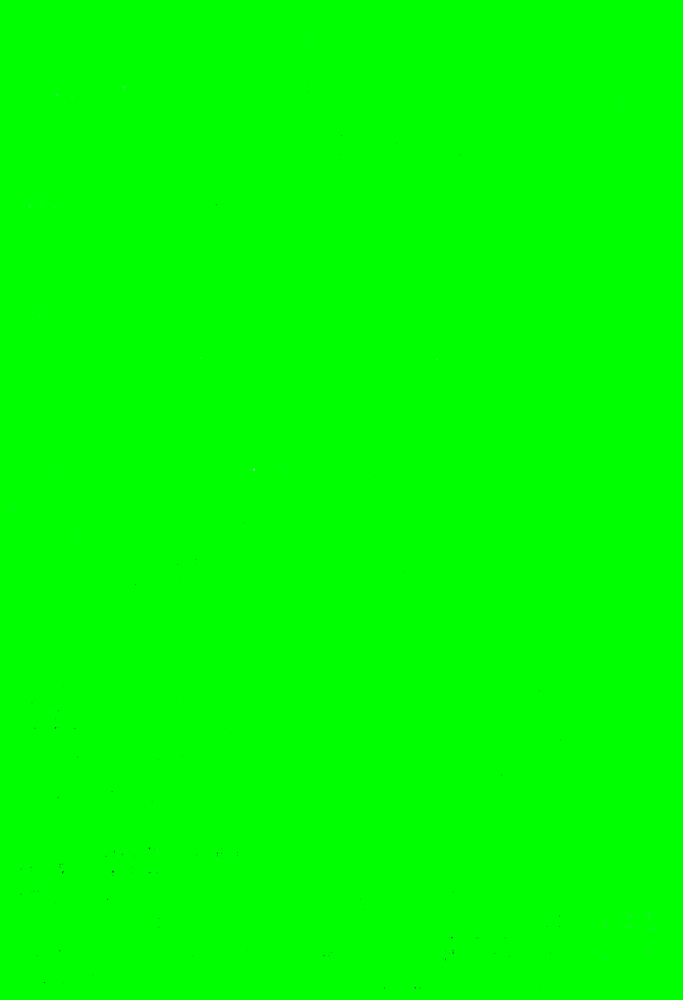

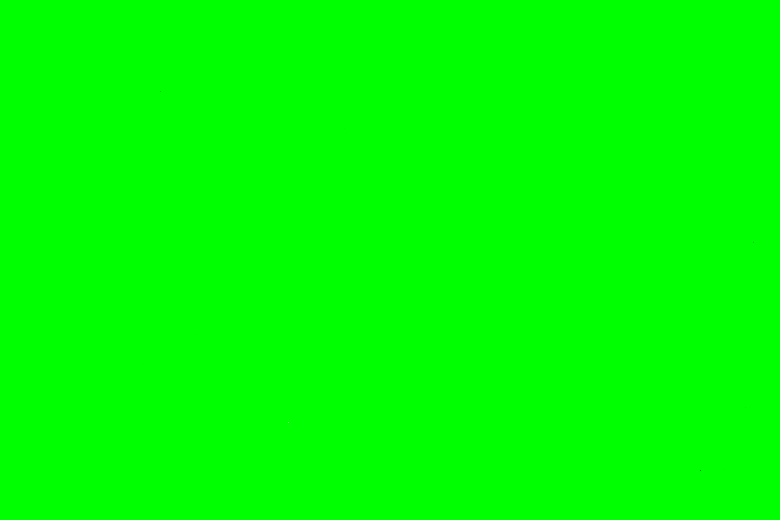

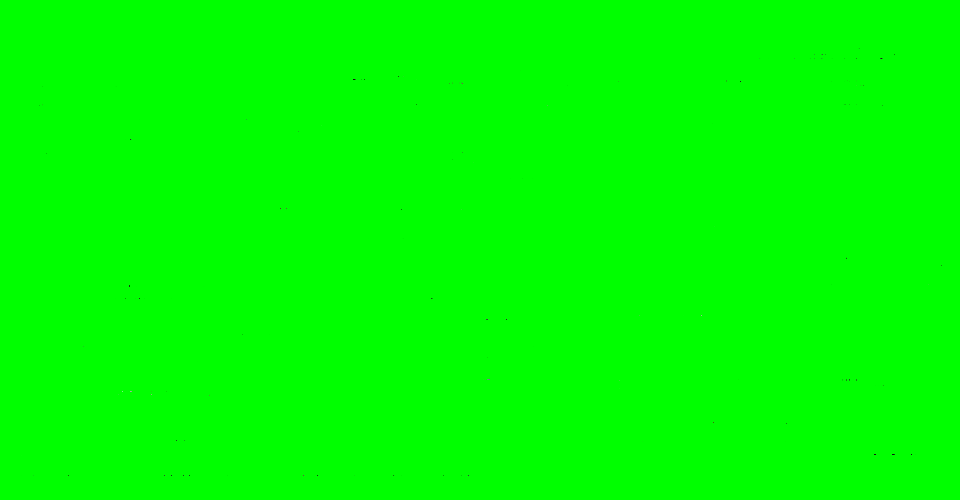

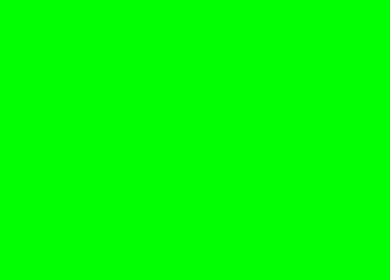

In [184]:
for image_name in boxes_results.keys():
    path_img = os.path.join(path_images_dir, image_name)
    boxes = boxes_results[image_name]
    draw_boxes(path_img, boxes)

All these fields draw on top of each other. As a human, you can see that all these frames belong to the same objects. However, the neural network is not human and thinks it has found several different objects (drones) that overlap each other, because it is theoretically possible that different objects in an image can overlap each other. It might sound crazy, but that's how it works.

It is up to you to choose which of these fields to keep and which to filter out. How can you do that? On one hand, you can select the box with the highest probability and remove all others. However, it is not a useful solution for all cases, as you can have images with several objects at the same time. You should find and use some general algorithm that removes all boxes that closely overlap each other. Fortunately, this algorithm already exists and is called non-maximal suppression. These are the steps you should take to make it work:

1) Create an empty result field that will contain the list of fields you want to keep.
2) Start the loop
3) Select the field with the highest probability from the source fields array and move it to the result array.
4) Compare the selected fields with each other from the source field and remove any that overlap too much with the selected one.
5) If the source field contains multiple fields, go to step 2 and repeat

After the loop completes, the source boxes array will be empty and the resulting array will only contain miscellaneous fields. Now we will understand how to implement step 4, how to compare two frames and find that they overlap each other too much. To find it, we will use another algorithm - *"Intersection over Union"* or *IoU*. This algorithm is actually a formula:

<center><img src="../img/filter.png" alt="Filter boxes" style="width: 700px;"/></center>

The idea behind this algorithm is:

1. Calculate the area of ​​the intersection of the two boxes.
2. Calculate the area of ​​their connection.
3. Let's divide one by the other

The closer the result is to 1, the more the two boxes overlap. You can see it visually: the closer the area of ​​intersection of two frames is to the area of ​​their connection, the more it looks like the same frame. In the left box below the formula, these boxes overlap each other, but not too much, and *IoU* in this case might be about *0.3*. The two boxes can definitely be considered different items, even if they overlap. In the second example, it is clear that the area of ​​intersection is much closer to the area of ​​their connection, perhaps an IoU of about 0.8 here. It is highly likely that one of these boxes should be removed. Finally, the boxes on the right swatch represent almost the same area and definitely only one of them should remain.

Now let's implement both *IoU* and *Non-Maximum suppression* in the code.

### ***Intersection over unification***

#### *1. Calculate the area of ​​intersection*

In [185]:
def intersection(box1,box2):
    box1_x1,box1_y1,box1_x2,box1_y2 = box1[:4]
    box2_x1,box2_y1,box2_x2,box2_y2 = box2[:4]
    x1 = max(box1_x1,box2_x1)
    y1 = max(box1_y1,box2_y1)
    x2 = min(box1_x2,box2_x2)
    y2 = min(box1_y2,box2_y2)
    return (x2-x1)*(y2-y1) 

Here we calculate the area of ​​the intersecting rectangle using its width $(x2-x1)$ and height $(y2-y1)$.

#### *2. Calculate the connection area*

In [186]:
def union(box1,box2):
    box1_x1,box1_y1,box1_x2,box1_y2 = box1[:4]
    box2_x1,box2_y1,box2_x2,box2_y2 = box2[:4]
    box1_area = (box1_x2-box1_x1)*(box1_y2-box1_y1)
    box2_area = (box2_x2-box2_x1)*(box2_y2-box2_y1)
    return box1_area + box2_area - intersection(box1,box2)

#### *3. divide one by the other*

In [187]:
def iou(box1,box2):
    return intersection(box1,box2)/union(box1,box2)

### ***Non-Maximum Suppression***

So we have an array of boxes in the boxes variable and we only need to keep different items in it, using the created iou function as the difference criterion. Let's say if the IoU of two boxes is less than 0.7 then both should stay. Otherwise, one of them should be less likely to leave. Let's implement it:

In [188]:
def check_iou_threshold(iou_threshold):
    file_path = os.path.join(PICKLE_PATH, 'iou_threshold.pkl')
    with open(file_path, 'wb') as f:  
        pickle.dump(round(iou_threshold, 2), f)
    return iou_threshold

In [189]:
interact(check_iou_threshold, iou_threshold=widgets.FloatSlider(min=0.1, max=1.0, step=0.01, value=0.70));

interactive(children=(FloatSlider(value=0.7, description='iou_threshold', max=1.0, min=0.1, step=0.01), Output…

In [197]:
with open(os.path.join(PICKLE_PATH, 'iou_threshold.pkl'), 'rb') as f:
    iou_threshold = pickle.load(f)

print(iou_threshold)

0.15


In [198]:
filtered_boxes = {}

In [199]:
for image_name in boxes_results.keys():
    boxes = boxes_results[image_name]
    boxes.sort(key=lambda x: x[5], reverse=True)
    result = []
    while len(boxes)>0:
        result.append(boxes[0])
        boxes = [box for box in boxes if iou(box,boxes[0])<iou_threshold]
    filtered_boxes[image_name] = result


In [200]:
#print('Filtered boxes: ', filtered_boxes)

### ***View results and save data***

In [201]:
# Funkce pro vykreslení detekcí na obrázku a jejich uložení
def draw_boxes2(image_path, model_name, boxes, output_dir, csv_path):
    img = Image.open(image_path)
    draw = ImageDraw.Draw(img)

    width, height = img.size
    ratio = height/width

    # Load the font
    font = ImageFont.truetype(FONT_PATH, int(FONT_SIZE*ratio))

    box_data = []
    for box in boxes:
        x1, y1, x2, y2, class_id, prob = box
        # Get color based on class_id
        color = COLOR_MAP.get(class_id, "#FFFFFF")  # Default to white if class_id not in map
        draw.rectangle((x1, y1, x2, y2), outline=color, width=2)
        draw.text((x1, y1 - (int(ratio*FONT_SIZE)+1)), f'{class_id} {prob:.2f}', font=font, fill=color)
        box_data.append([x1, y1, x2, y2, class_id, prob])
    
    # Uložení obrázku
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    image_name = os.path.basename(image_path)
    output_image_path = os.path.join(output_dir, 'results_' + str(model_name) + '_' + image_name.split('.')[0] + '.jpg')
    img.save(output_image_path)

    # Uložení boxů do CSV pomocí knihovny csv
    output_csv_path = os.path.join(csv_path, 'results_' + str(model_name) + '_' + image_name.split('.')[0] + '.csv')
    file_exists = os.path.isfile(output_csv_path)
    with open(output_csv_path, mode='a', newline='') as file:
        writer = csv.writer(file)
        if not file_exists:
            writer.writerow(['x1', 'y1', 'x2', 'y2', 'class_id', 'prob'])
        writer.writerows(box_data)

    print(f'Results saved to {output_image_path} and {output_csv_path}')

In [202]:
for image_name in filtered_boxes.keys():
    path_img = os.path.join(path_images_dir, image_name)
    boxes = filtered_boxes[image_name]
    draw_boxes2(path_img, sel_data[0], boxes, path_results_dir, path_results_dir)

Results saved to ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image1.jpg and ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image1.csv
Results saved to ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image2.jpg and ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image2.csv
Results saved to ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image3.jpg and ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image3.csv
Results saved to ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image4.jpg and ..\data\images\results\onnxruntime\results_YOLOv6m_FMD_02_test-image4.csv


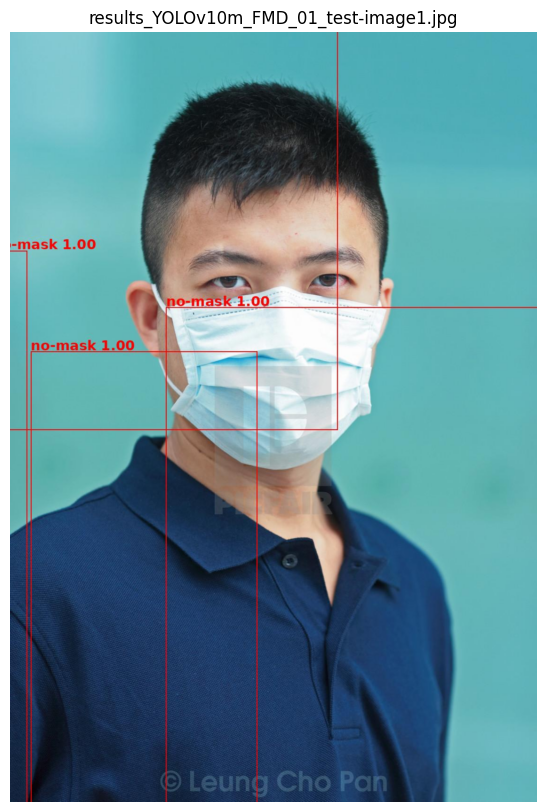

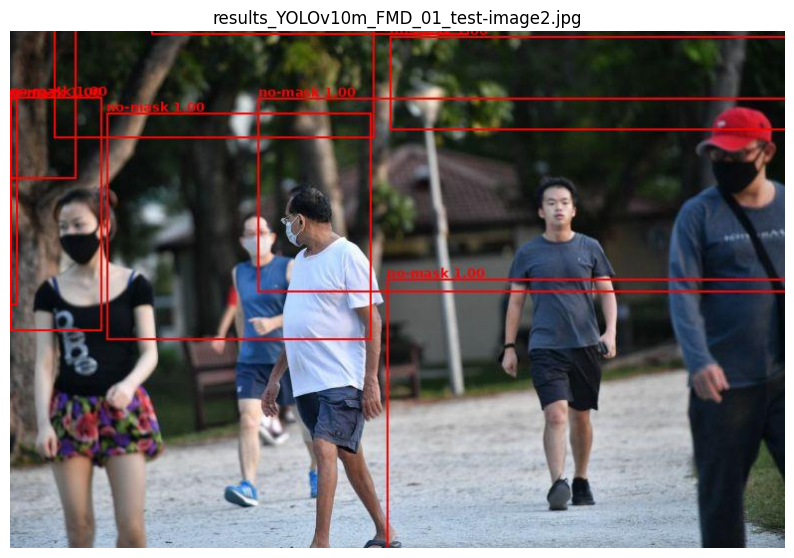

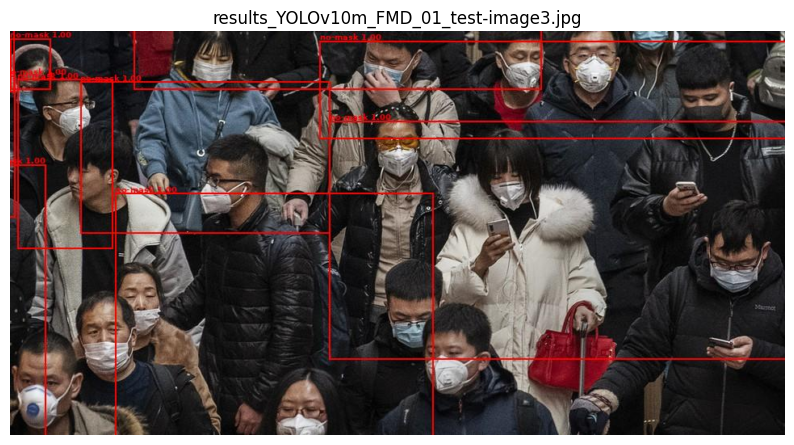

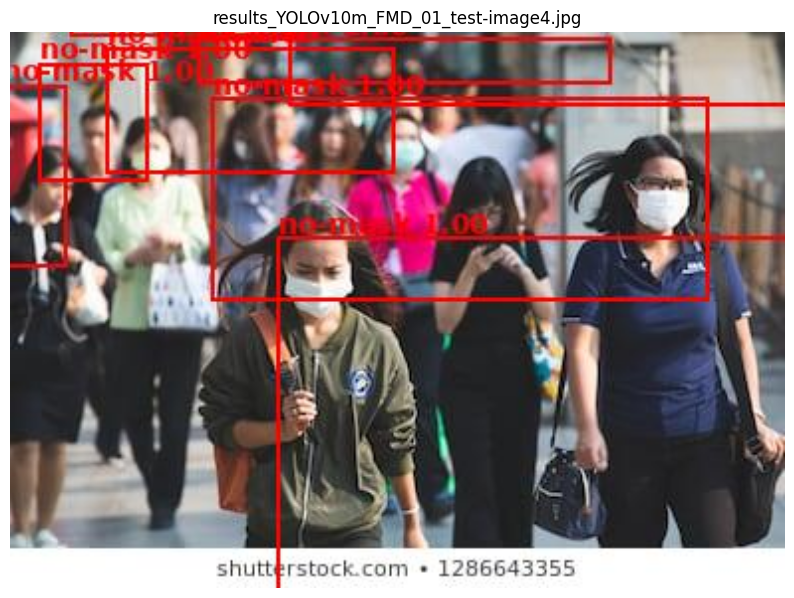

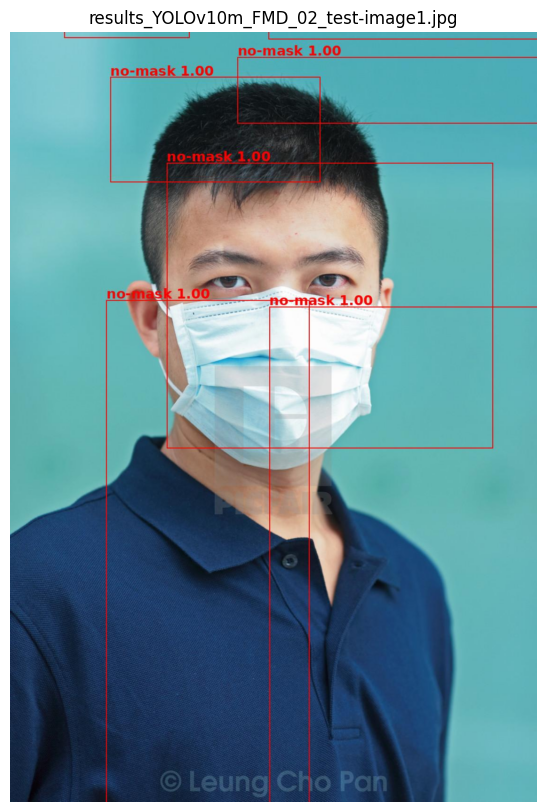

...

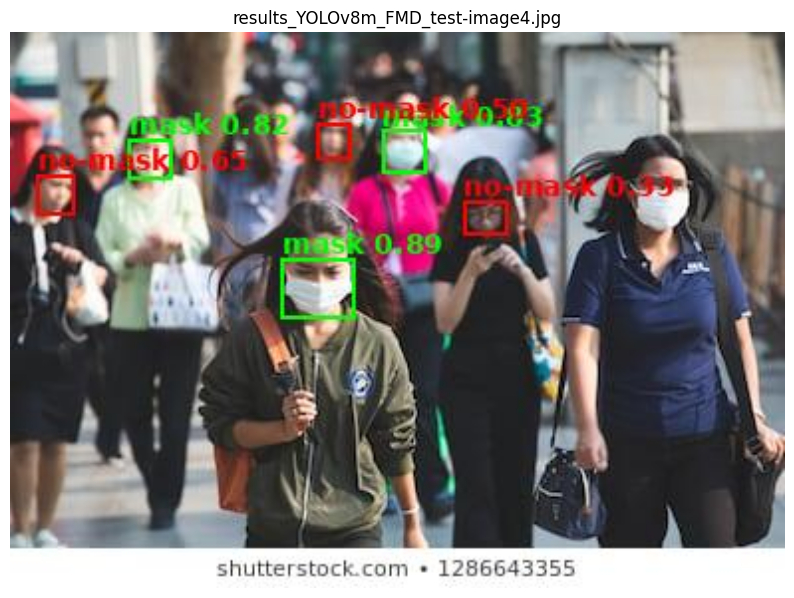

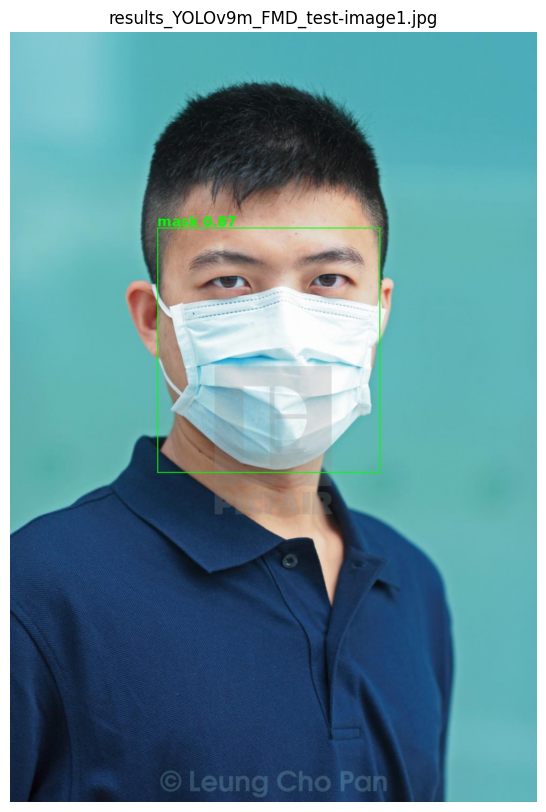

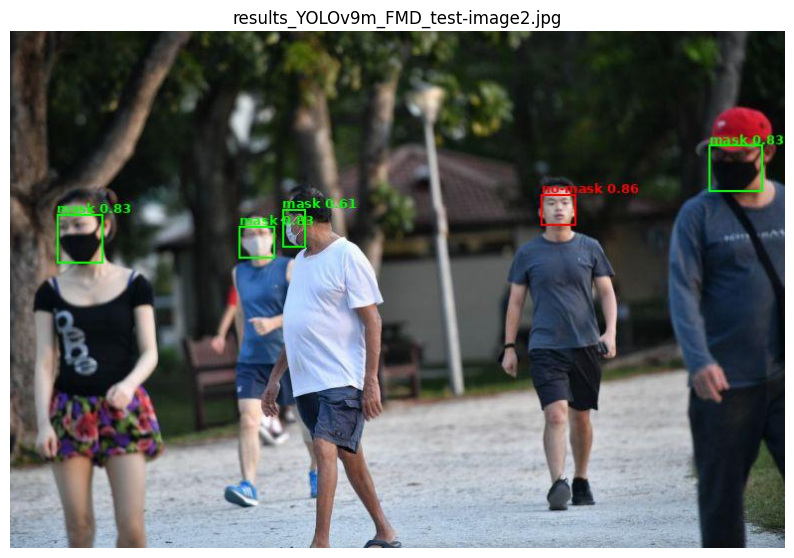

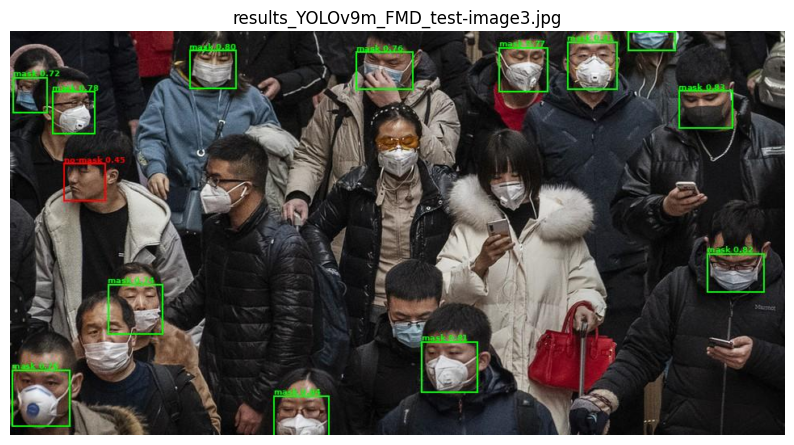

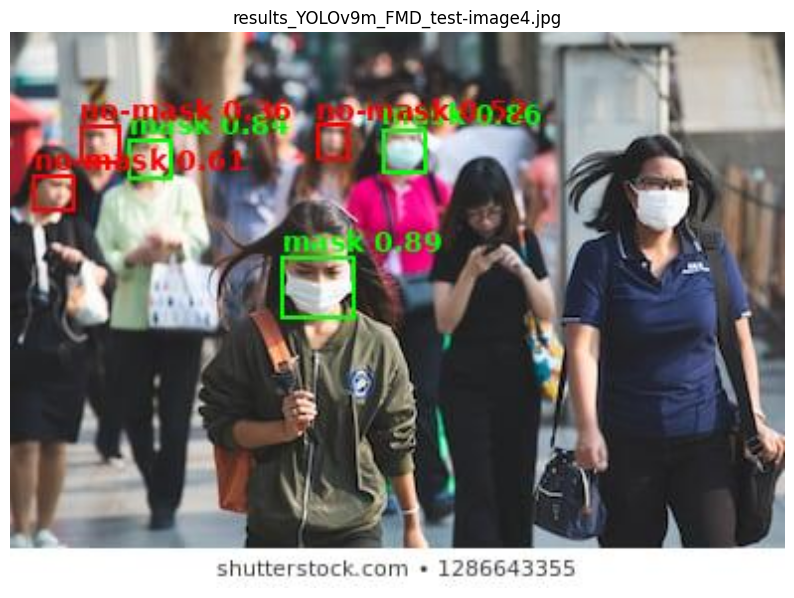

In [203]:
list_results = load_images(path_results_dir)

for result in list_results:
    path = os.path.join(path_results_dir, result)
    image = cv2.imread(path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.title(result)
    plt.axis('off')
    plt.show()

## References and other materials

[ONNX Export for YOLOv8 Models](https://docs.ultralytics.com/integrations/onnx/)

[Model Export with Ultralytics YOLO](https://docs.ultralytics.com/modes/export/#introduction)

[Model Training with Ultralytics YOLO](https://docs.ultralytics.com/modes/train/)

[How to create YOLOv8-based object detection web service using Python, Julia, Node.js, JavaScript, Go and Rust](https://dev.to/andreygermanov/how-to-create-yolov8-based-object-detection-web-service-using-python-julia-nodejs-javascript-go-and-rust-4o8e)

[How to detect objects on images using the YOLOv8 neural network](https://dev.to/andreygermanov/a-practical-introduction-to-object-detection-with-yolov8-neural-network-3n8c)